In [1]:
import os

import numpy as np
import cv2
import matplotlib.pyplot as plt

#### Read dataset

In [2]:
INPUT_FOLDER = "input"
IMAGES_FOLDER = "img"

In [3]:
def get_images(dataset):
    # Sort images in ascending order
    dataset_path = os.path.join(INPUT_FOLDER, dataset, IMAGES_FOLDER)
    names = sorted(os.listdir(dataset_path), key=lambda name: int(name.split(".")[0]))
    paths = (os.path.join(dataset_path, name) for name in names)
    return [cv2.imread(path) for path in paths]

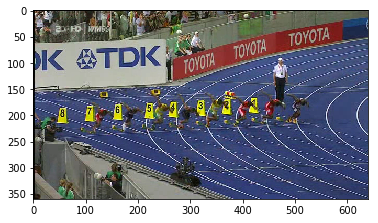

In [4]:
bolt = get_images("Bolt")
plt.imshow(cv2.cvtColor(bolt[0], cv2.COLOR_BGR2RGB));

#### Implement patch matching similarity functions

In [17]:
def ssd(f1, f2):
    # Sum of squared differences
    return np.sum((f1 - f2) ** 2)


def ncc(f1, f2):
    # Normalized cross correlation
    return -np.sum(f1 * f2)


def sad(f1, f2):
    # Sum of absolute difference
    return np.sum(np.abs(f1 - f2))


similarity_functions = {"ssd": ssd, "ncc": ncc, "sad": sad}

In [6]:
def normalize_template(image):
    return (image - image.mean((0, 1))) / image.var((0, 1))

In [27]:
def template_match(roi, original_image, match_image, method="ssd", **kwargs):
    blur = kwargs.get("blur", False)
    normalize = kwargs.get("normalize", False)

    x, y, w, h = roi
    IMAGE_HEIGHT, IMAGE_WIDTH = original_image.shape[0:2]
        
    similarity_func = similarity_functions[method]

    if blur:
        original_image = cv2.GaussianBlur(original_image, (5, 5), 0)
        match_image = cv2.GaussianBlur(match_image, (5, 5), 0)

    original_template = original_image[y : y + h, x : x + w]
    if normalize:
        original_template = normalize_template(original_template)

    best_similarity = np.infty
    best_x, best_y = 0, 0

    for i in range(0, IMAGE_HEIGHT - h):
        for j in range(0, IMAGE_WIDTH - w):
            template = match_image[i : i + h, j : j + w]
            if normalize:
                template = normalize_template(template)
            similarity = similarity_func(original_template, template)
            if similarity < best_similarity:
                best_similarity = similarity
                best_x, best_y = j, i

    return best_x, best_y, w, h

####  Define helper function for comparing frames

In [8]:
def show_frames(imgs, rois, per_row=2):
    n = len(imgs)
    rows = (n + per_row - 1) // per_row
    cols = min(per_row, n)
    fig, axes = plt.subplots(
        rows, cols, figsize=(32 // per_row * cols, 18 // per_row * rows)
    )
    for ax in axes.flatten():
        ax.axis("off")
    for i, (img, ax) in enumerate(zip(imgs, axes.flatten())):
        converted = cv2.cvtColor(img.copy(), cv2.COLOR_BGR2RGB)
        x, y, w, h = rois[i]
        cv2.rectangle(converted, (x, y), (x + w, y + h), (0, 255, 0), 2)
        ax.imshow(converted)

In [9]:
FRAMES_COUNT = 6
# start_roi = (335, 164, 27, 49)
start_roi = (336,165,26,61)

### Test SSD function

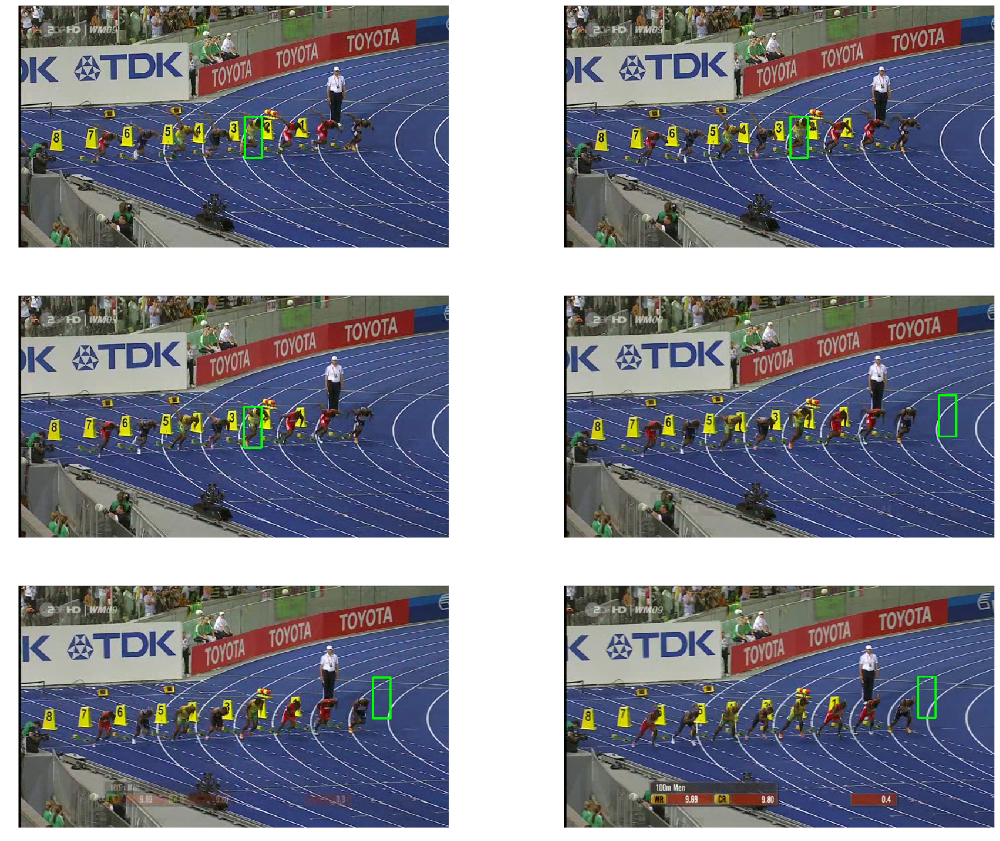

In [10]:
rois = [start_roi]

for i in range(FRAMES_COUNT):
    next_roi = template_match(start_roi, bolt[0], bolt[i], "ssd")
    rois.append(next_roi)

show_frames(bolt[0:FRAMES_COUNT], rois)

##### Single SSD matched well only three consecutive frames

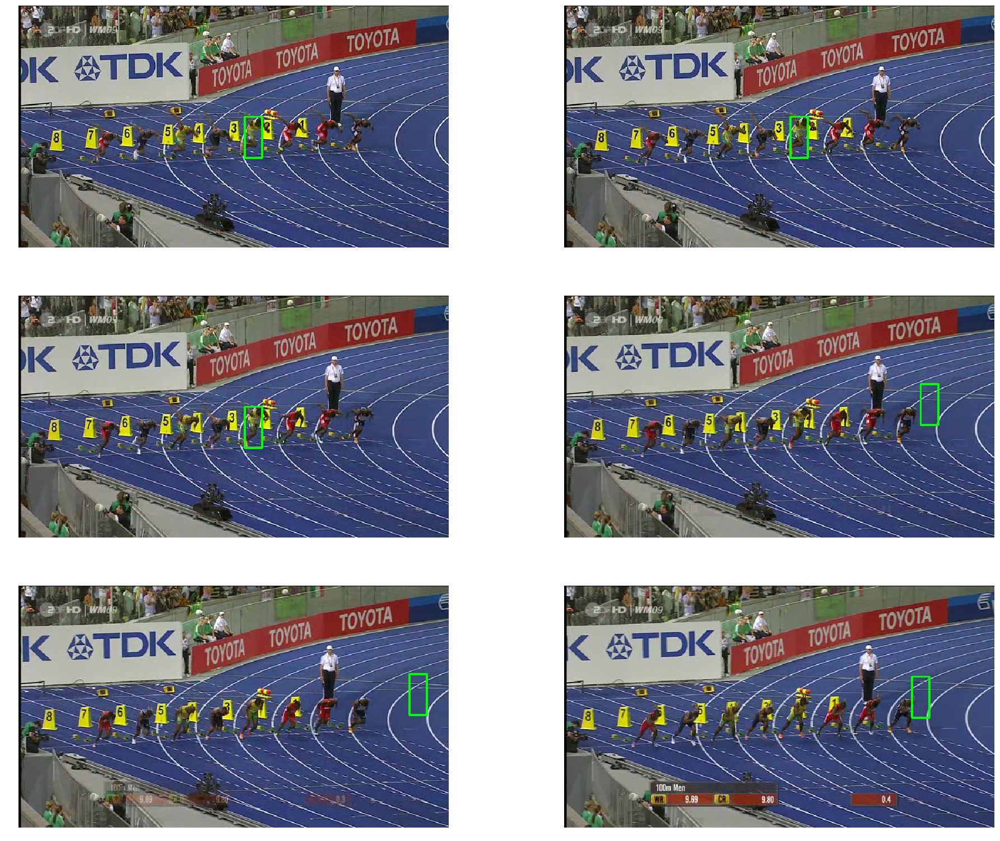

In [11]:
rois = [start_roi]

for i in range(FRAMES_COUNT):
    next_roi = template_match(start_roi, bolt[0], bolt[i], "ssd", blur=True)
    rois.append(next_roi)

show_frames(bolt[0:FRAMES_COUNT], rois)

##### SSD with blur worked better, matched four consecutive frames

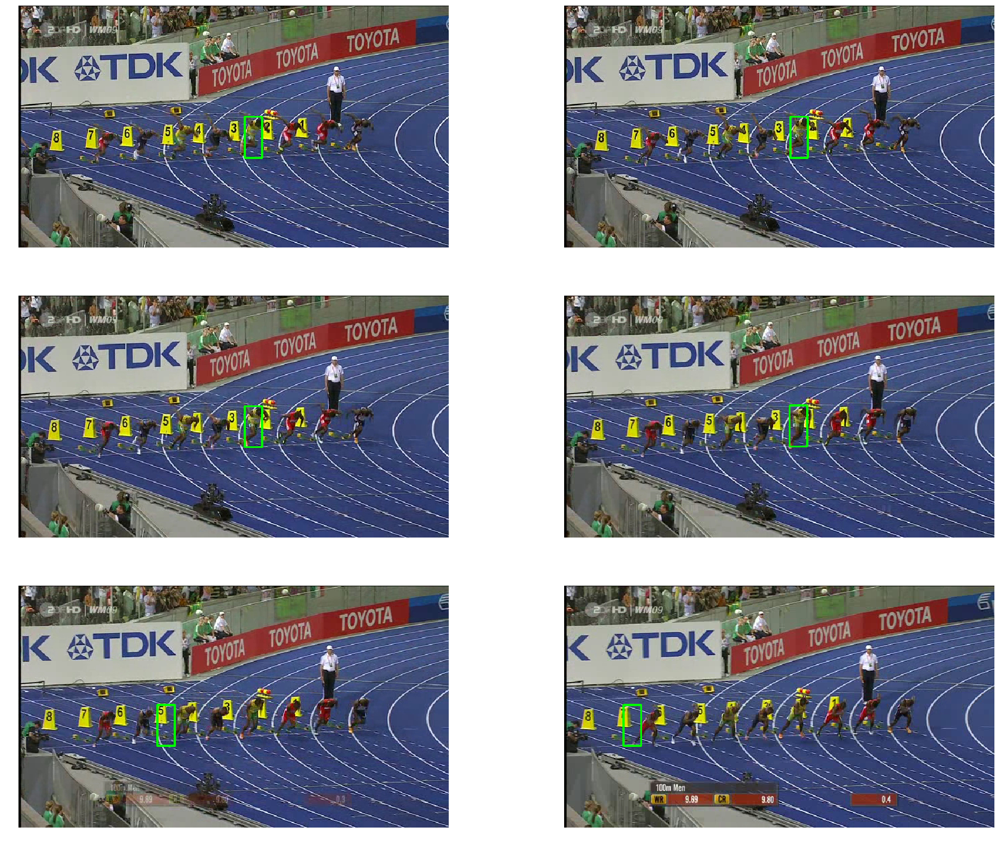

In [12]:
rois = [start_roi]

for i in range(FRAMES_COUNT):
    next_roi = template_match(
        start_roi, bolt[0], bolt[i], "ssd", blur=True, normalize=True
    )
    rois.append(next_roi)

show_frames(bolt[0:FRAMES_COUNT], rois)

##### Normalization didn't improved much the results of the SSD with image blurring. Four templates were matched well

#### Test SAD function

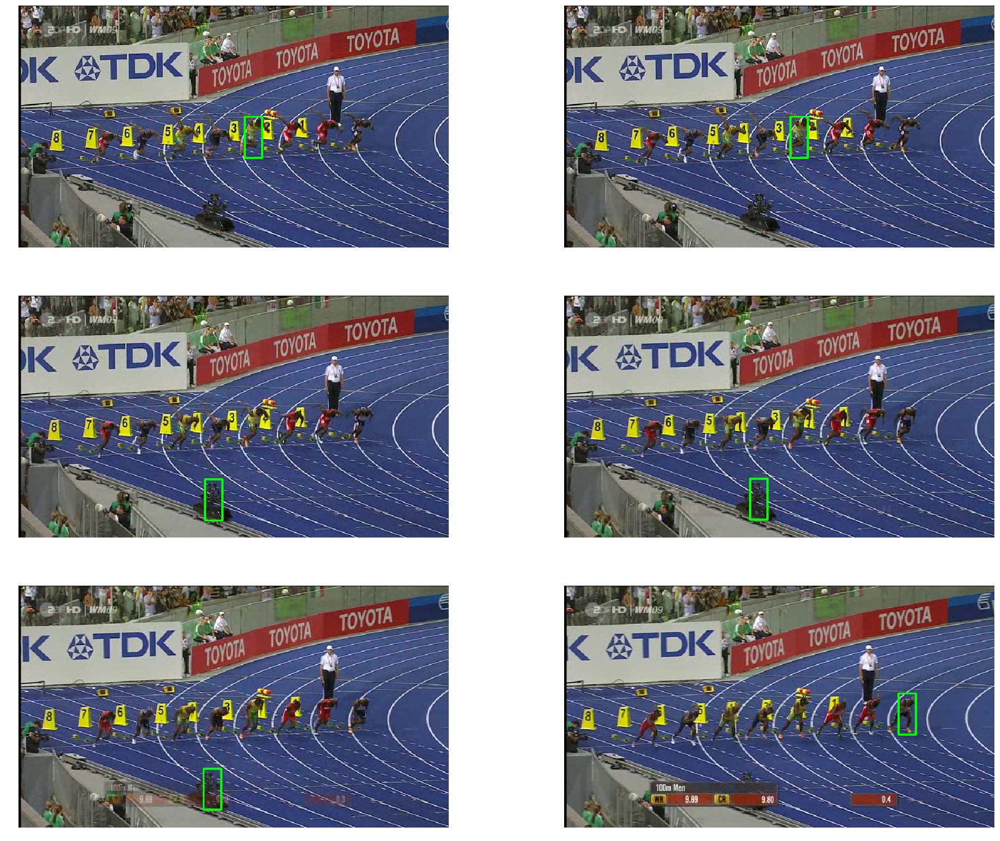

In [13]:
rois = [start_roi]

for i in range(FRAMES_COUNT):
    next_roi = template_match(start_roi, bolt[0], bolt[i], "sad")
    rois.append(next_roi)

show_frames(bolt[0:FRAMES_COUNT], rois)

##### Single sum of absolute differences worked well only on 1 consecutive frame. Then it started matching dark templates (maybe, because of small pixel values there)

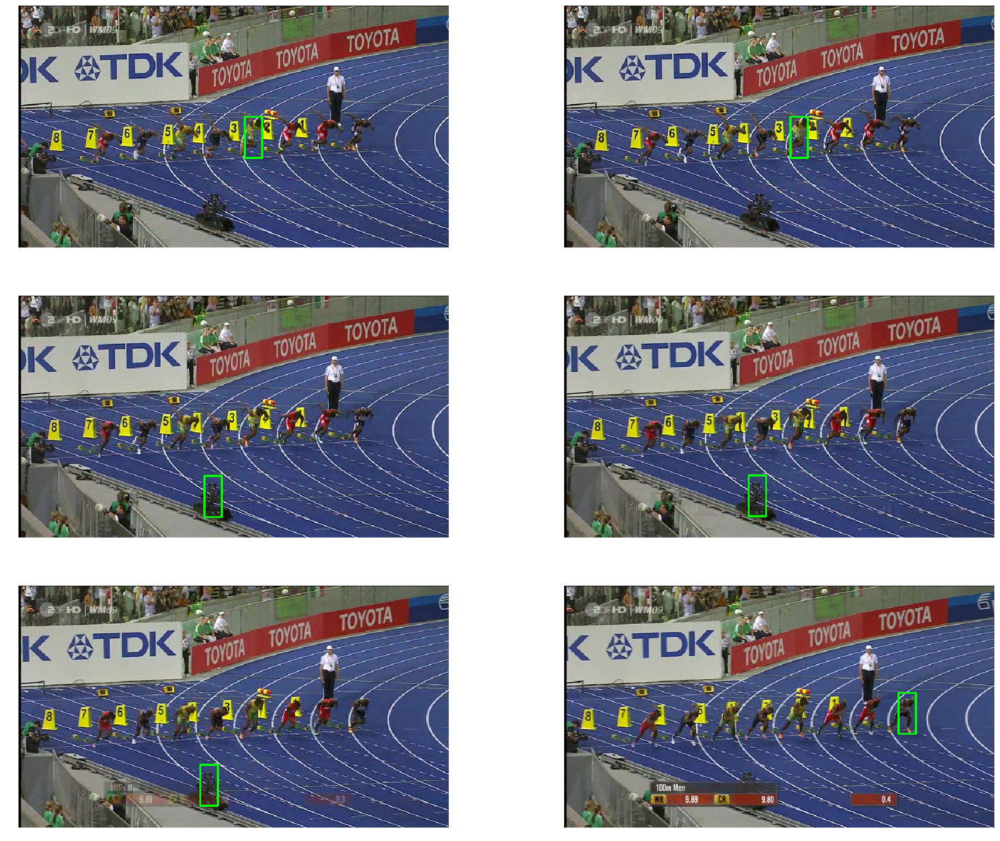

In [14]:
rois = [start_roi]

for i in range(FRAMES_COUNT):
    next_roi = template_match(start_roi, bolt[0], bolt[i], "sad", blur=True)
    rois.append(next_roi)

show_frames(bolt[0:FRAMES_COUNT], rois)

##### Blurring didn't improved results here. Only one template was matched. On other images black camera was matched

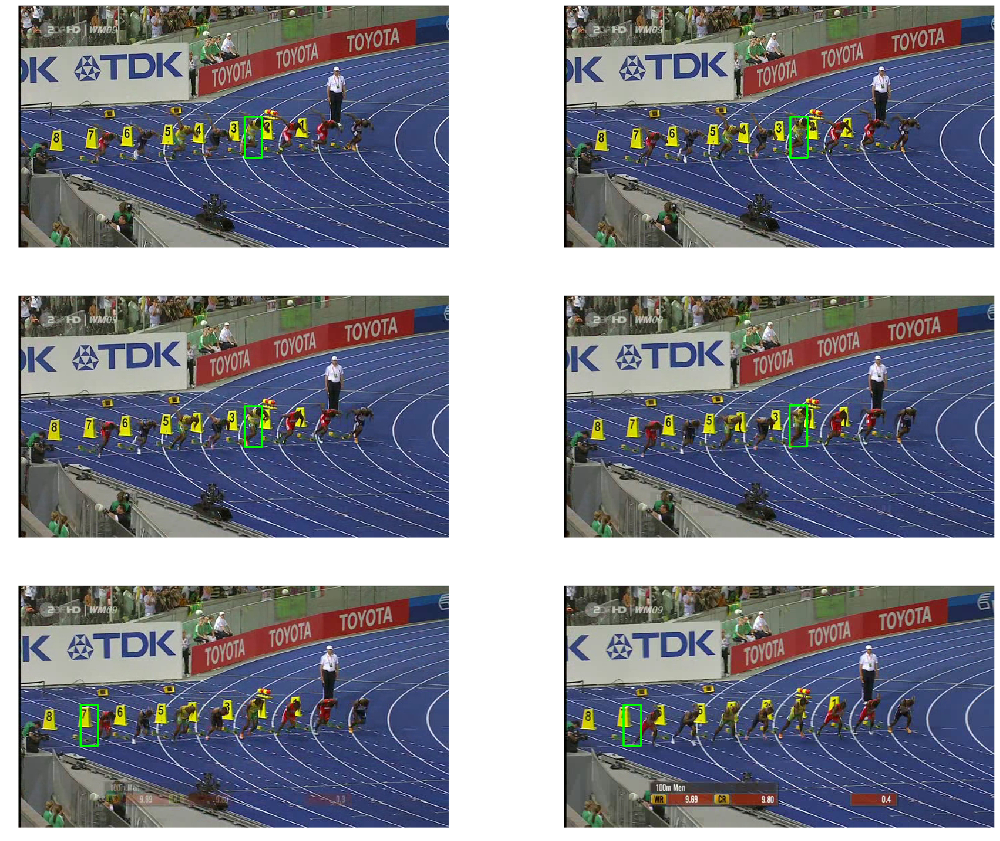

In [15]:
rois = [start_roi]

for i in range(FRAMES_COUNT):
    next_roi = template_match(
        start_roi, bolt[0], bolt[i], "sad", blur=True, normalize=True
    )
    rois.append(next_roi)

show_frames(bolt[0:FRAMES_COUNT], rois)

##### Normalizing improved SAD results. Templates on three images were matched.

#### Test NCC function

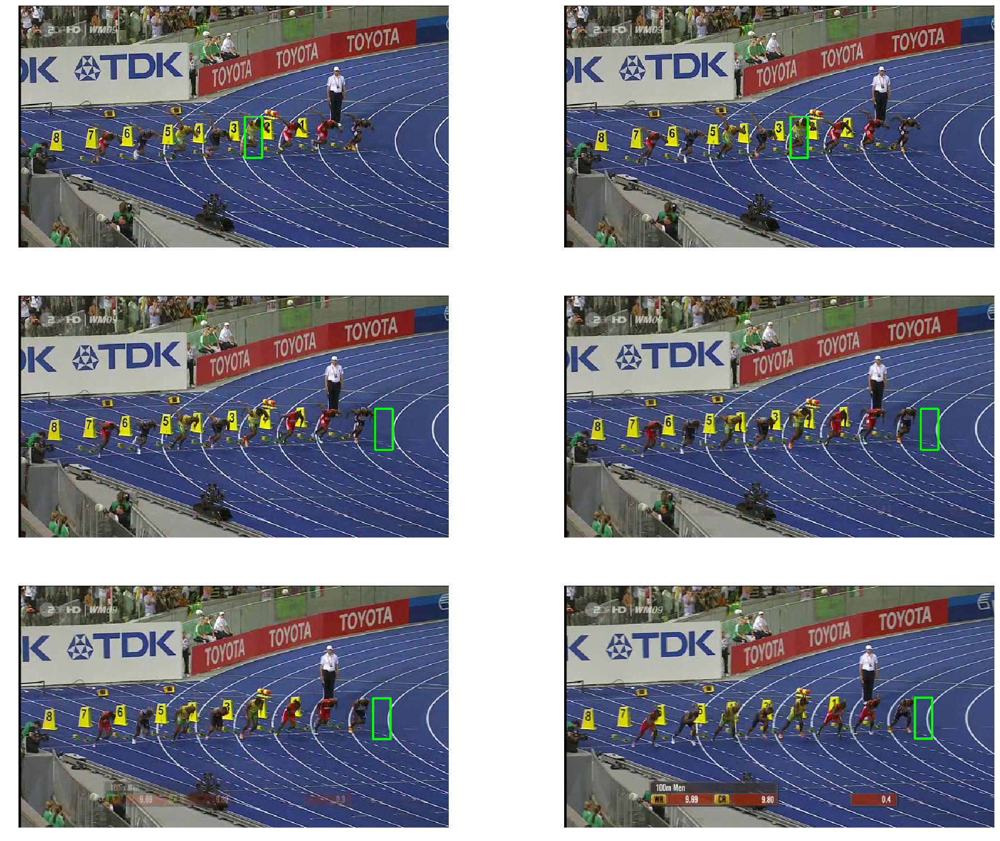

In [18]:
rois = [start_roi]

for i in range(FRAMES_COUNT):
    next_roi = template_match(start_roi, bolt[0], bolt[i], "ncc", normalize=True)
    rois.append(next_roi)

show_frames(bolt[0:FRAMES_COUNT], rois)

##### NCC could match only one template in consecutive frame

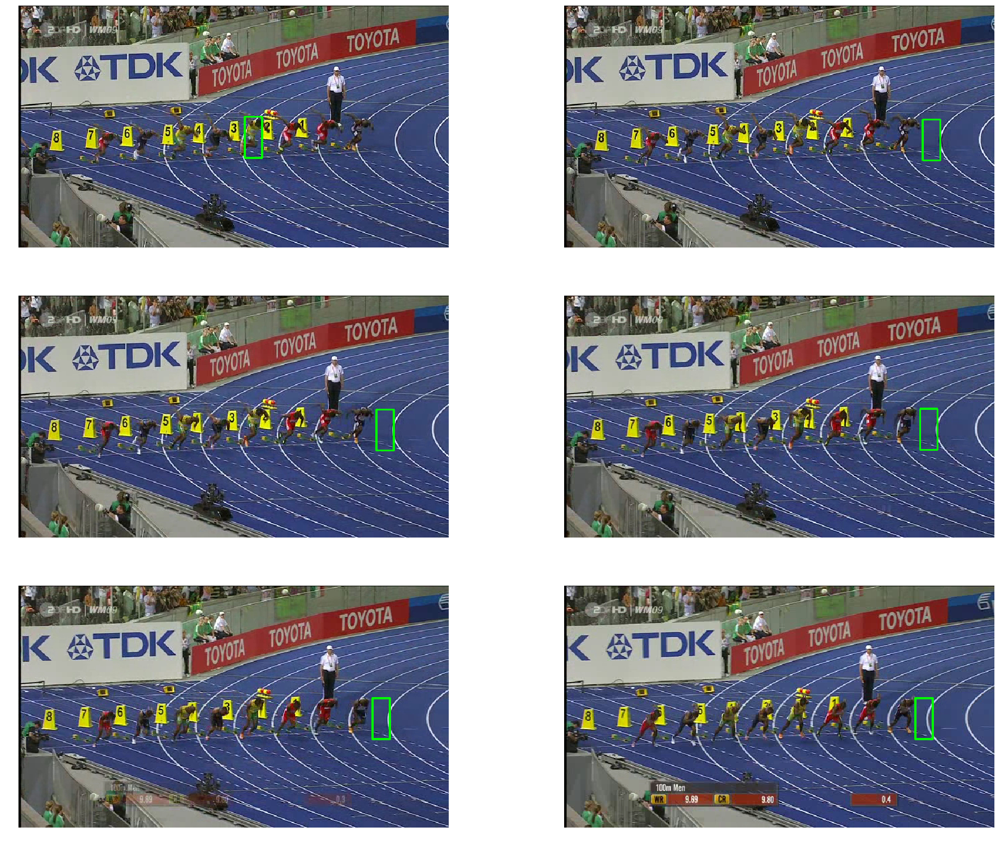

In [19]:
rois = [start_roi]

for i in range(FRAMES_COUNT):
    next_roi = template_match(start_roi, bolt[0], bolt[i], "ncc", normalize=True, blur=True)
    rois.append(next_roi)

show_frames(bolt[0:FRAMES_COUNT], rois)

##### Blurring NCC didn't improve results.

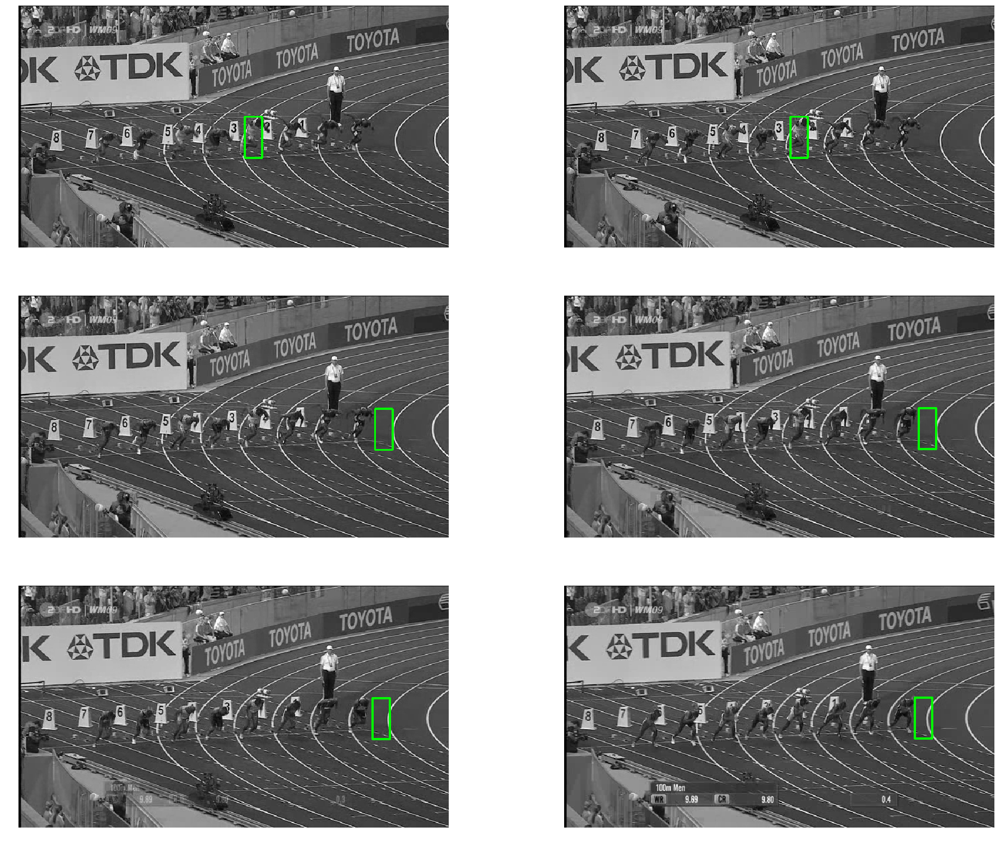

In [29]:
rois = [start_roi]
bolt_gray = [cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY) for frame in bolt]

for i in range(FRAMES_COUNT):
    next_roi = template_match(start_roi, bolt_gray[0], bolt_gray[i], "ncc", normalize=True)
    rois.append(next_roi)

show_frames(bolt_gray[0:FRAMES_COUNT], rois)

##### Grayscaling images also didn't improved NCC results